##     Explore dataset

**Loading dataset** 

Dataset used with temperature information is based on Weather Dataset (https://www.kaggle.com/datasets/muthuj7/weather-dataset) and is stored in a public github repository. 

In [1]:
import pandas as pd

#based on dataset https://www.kaggle.com/datasets/muthuj7/weather-dataset
#Import dataset dates from github
url = 'https://raw.githubusercontent.com/mabrotons/datasets/master/weatherHistory_2015_1D.csv'

df = pd.read_csv(url, index_col=False, parse_dates=['Formatted Date'])

df.sort_values(by='Formatted Date', inplace = True)
df.set_index('Formatted Date', inplace = True)

print("Data frame info: ") 
print(df.info())

print("\nData frame head: ") 
print(df.head())

print("\nDescribe: ") 
print(df.describe())

Data frame info: 
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 87669 entries, 2006-01-01 00:00:00 to 2015-12-31 23:00:00
Data columns (total 1 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Temperature (C)  87669 non-null  float64
dtypes: float64(1)
memory usage: 1.3 MB
None

Data frame head: 
                     Temperature (C)
Formatted Date                      
2006-01-01 00:00:00         1.161111
2006-01-01 01:00:00         1.666667
2006-01-01 02:00:00         1.711111
2006-01-01 03:00:00         1.183333
2006-01-01 04:00:00         1.205556

Describe: 
       Temperature (C)
count     87669.000000
mean         11.927328
std           9.602300
min         -21.822222
25%           4.655556
50%          12.066667
75%          18.838889
max          39.905556


As a first step on the analysis, we will build a graph to represent all the data included in the dataset in order to have a first view of the data (time line) and its distribution, max, min and mean values.

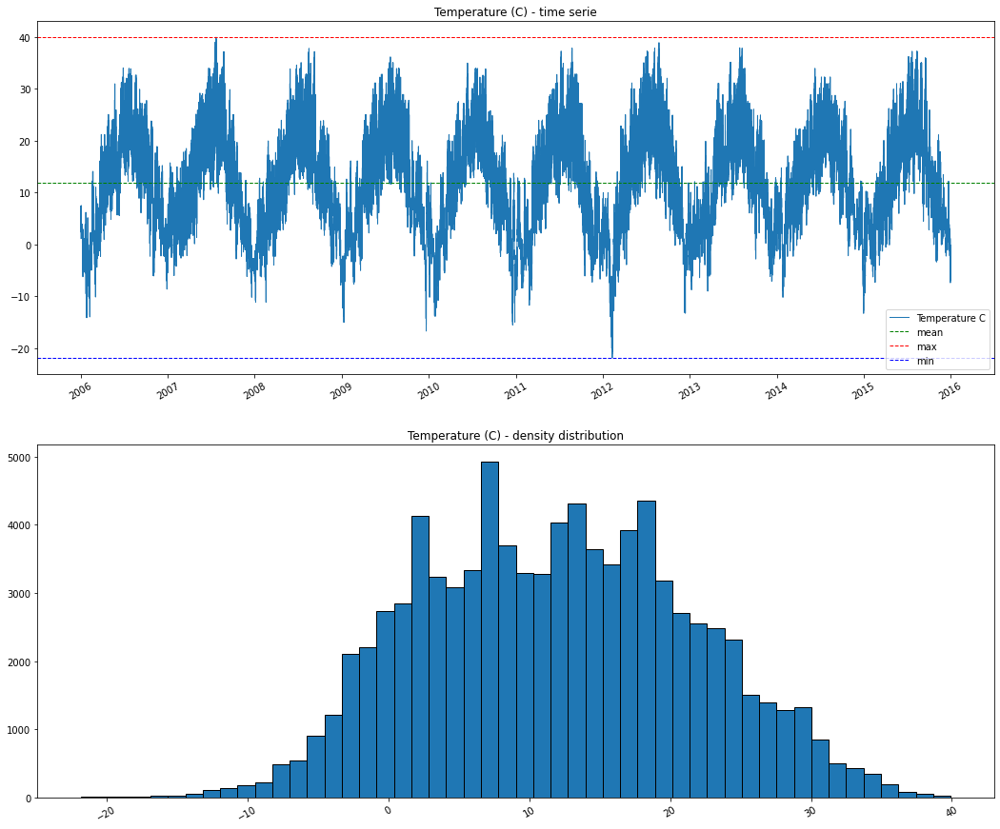

In [2]:
import matplotlib.pyplot as plt

fig, axes =plt.subplots(2, 1, figsize=(18, 15))

axes[0].plot(df.index, df['Temperature (C)'], label='Temperature C', linewidth=1)

#add horizontal lines at mean value of x
mean_temp = df['Temperature (C)'].mean()
max_temp = df['Temperature (C)'].max()
min_temp = df['Temperature (C)'].min()

axes[0].axhline(y=mean_temp, color='green', linewidth=1, label='mean', linestyle='dashed')
axes[0].axhline(y=max_temp, color='red', linewidth=1, label='max', linestyle='dashed')
axes[0].axhline(y=min_temp, color='blue', linewidth=1, label='min', linestyle='dashed')
axes[1].hist(df['Temperature (C)'], bins=50, edgecolor='black')

axes[0].title.set_text('Temperature (C) - time serie')
axes[1].title.set_text('Temperature (C) - density distribution')

axes[0].tick_params('x', labelrotation=30)
axes[1].tick_params('x', labelrotation=30)

axes[0].legend()

plt.show()

In the case, as we can appreciate in the time series chart, we are working with a seasonal time series, where there is a clear pattern of year's seasons. By the other hand, we can see that temperature datapoint distribution  is very close to a normal distribution.

The seasonal characteristic of this time series means that the global statistical functions such as the mean, the maximum and the minimum, being at a global level, only provide data at that level but distorting the data in each of the seasons of each year. For this reason, it would be interesting to analyze this data set using maximum, minimum and average metrics, aggregating the information at a monthly, weekly and daily level.

The three graphs will show us in three different time scales and through the red areas (temperatures above the average for the period) and the blue areas (temperatures below the average for the period) the different temperature ranges recorded throughout of the time line.

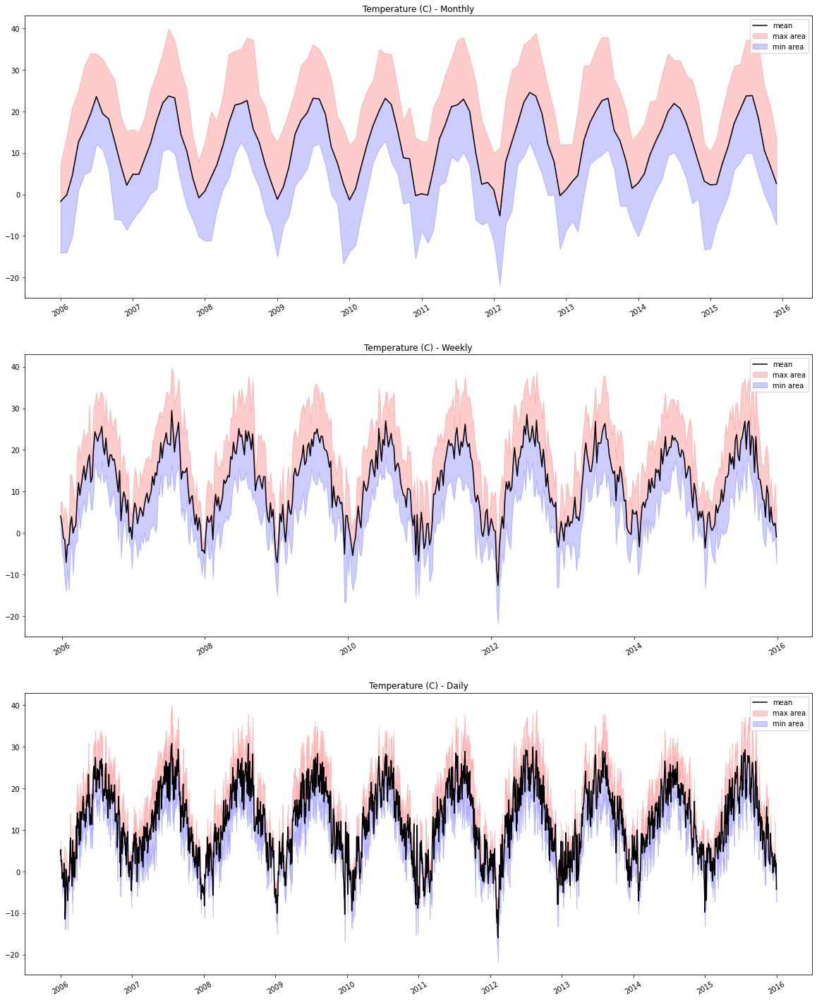

In [3]:
fig, axes =plt.subplots(3, 1, figsize=(20, 25))

month_agg = df.groupby(df.index.to_period("M"))['Temperature (C)'].agg(['min', 'mean', 'max', 'std']) #Monthly
axes[0].plot(month_agg.index.astype('datetime64'), month_agg['mean'], color='black', label='mean') 
axes[0].fill_between(month_agg.index.astype('datetime64'), month_agg['max'], month_agg['mean'], alpha=0.2, color='red', label='max area')
axes[0].fill_between(month_agg.index.astype('datetime64'), month_agg['min'], month_agg['mean'], alpha=0.2, color='blue', label='min area')
axes[0].legend()

week_agg = df.groupby(df.index.to_period("W"))['Temperature (C)'].agg(['min', 'mean', 'max', 'std']) #Monthly
axes[1].plot(week_agg.index.astype('datetime64'), week_agg['mean'], color='black', label='mean') 
axes[1].fill_between(week_agg.index.astype('datetime64'), week_agg['max'], week_agg['mean'], alpha=0.2, color='red', label='max area')
axes[1].fill_between(week_agg.index.astype('datetime64'), week_agg['min'], week_agg['mean'], alpha=0.2, color='blue', label='min area')
axes[1].legend()

day_agg = df.groupby(df.index.to_period("D"))['Temperature (C)'].agg(['min', 'mean', 'max', 'std']) #Monthly
axes[2].plot(day_agg.index.astype('datetime64'), day_agg['mean'], color='black', label='mean') 
axes[2].fill_between(day_agg.index.astype('datetime64'), day_agg['max'], day_agg['mean'], alpha=0.2, color='red', label='max area')
axes[2].fill_between(day_agg.index.astype('datetime64'), day_agg['min'], day_agg['mean'], alpha=0.2, color='blue', label='min area')
axes[2].legend()

axes[0].title.set_text('Temperature (C) - Monthly')
axes[1].title.set_text('Temperature (C) - Weekly')
axes[2].title.set_text('Temperature (C) - Daily')

axes[0].tick_params('x', labelrotation=30)
axes[1].tick_params('x', labelrotation=30)
axes[2].tick_params('x', labelrotation=30)

plt.show()

##     Detecting outliers with basic statistics
The z-score is a calculation that measure how many standard deviations a value is far away from the mean, and the probability of data to be unusual in a distribution. Datapoints values above the mean will have positive standard scores and datapoints values below the mean have negative standard scores. 

Z = (x – μ) / σ

where Z is the score, x is the value to calculate the score, μ is the mean and σ is the standard deviation.

- if a z-score returned is lower than 1 shoud be a normal data value
- if a z-score returned is larger than 1 and lower than 3, could be an error
- if a z-score returned is larger than 3 should be an error

In [4]:
std_temp = df['Temperature (C)'].std()
df['zscore_global'] = [(a-mean_temp)/std_temp for a in df['Temperature (C)']] 
print("\nMean deviation of temperatures: " + str(mean_temp))
print("Standard deviation of temperatures: " + str(std_temp))

df['zscore_global_class'] = ''
df.loc[(df['zscore_global'] <= 1) & (df['zscore_global'] >= -1), 'zscore_global_class'] = 'good zscore'
df.loc[((df['zscore_global'] > 1) & (df['zscore_global'] <= 3)) | ((df['zscore_global'] < -1) & (df['zscore_global'] >= -3)), 'zscore_global_class'] = 'regular zscore'
df.loc[(df['zscore_global'] > 3) | (df['zscore_global'] < -3), 'zscore_global_class'] = 'bad zscore'
 
print("\nTotal registers: " + str(len(df)))
print("z-score <1 registers: " + str(len(df.loc[df['zscore_global_class'] == 'good zscore'])))
print("z-score >1 & <3 registers: " + str(len(df.loc[df['zscore_global_class'] == 'regular zscore'])))
print("z-score >3 registers: " + str(len(df.loc[df['zscore_global_class'] == 'bad zscore'])))


Mean deviation of temperatures: 11.927327663015307
Standard deviation of temperatures: 9.602299890482259

Total registers: 87669
z-score <1 registers: 56498
z-score >1 & <3 registers: 31133
z-score >3 registers: 38


Let's build a graph printing this results labeling with its score calculated.

In [5]:
import plotly.express as pltx

color_discrete_map = {'regular zscore': 'orange', 'good zscore': 'green', 'bad zscore': 'red'}
fx = pltx.scatter(df.reset_index(), 'Formatted Date', 'Temperature (C)', color='zscore_global_class', color_discrete_map=color_discrete_map)
fx.update_xaxes (rangeslider_visible=True,)
fx.update_traces(marker_size=3)
fx.show()

print('\n Zscore >3 temperatures:')
print(df.loc[df['zscore_global_class'] == 'bad zscore'])


 Zscore >3 temperatures:
                     Temperature (C)  zscore_global zscore_global_class
Formatted Date                                                         
2012-02-05 19:00:00       -17.777778      -3.093541          bad zscore
2012-02-05 21:00:00       -16.894444      -3.001549          bad zscore
2012-02-08 01:00:00       -17.222222      -3.035684          bad zscore
2012-02-08 02:00:00       -17.222222      -3.035684          bad zscore
2012-02-08 04:00:00       -17.777778      -3.093541          bad zscore
2012-02-08 05:00:00       -20.000000      -3.324967          bad zscore
2012-02-08 06:00:00       -18.511111      -3.169911          bad zscore
2012-02-08 07:00:00       -17.777778      -3.093541          bad zscore
2012-02-08 18:00:00       -17.294444      -3.043206          bad zscore
2012-02-08 19:00:00       -17.222222      -3.035684          bad zscore
2012-02-08 20:00:00       -17.222222      -3.035684          bad zscore
2012-02-08 21:00:00       -19.777778  

But since this is a time series with seasonality pattern, we can carry out the same exercise by applying the z-score with the aggregated data at a monthly, weekly and daily level, where mean and standard deviation will be calculated.

Monthly:

In [6]:
#adding a new column with date to be used like an index after merge
df['date'] = df.index

merged_inner_month = pd.merge(left=df,right=month_agg, left_on=df.index.to_period("M"), right_on=month_agg.index)

merged_inner_month['zscore_agg'] = (merged_inner_month['Temperature (C)']-merged_inner_month['mean'])/merged_inner_month['std'] 

merged_inner_month['zscore_agg_class'] = ''
merged_inner_month.loc[(merged_inner_month['zscore_agg'] <= 1) & (merged_inner_month['zscore_agg'] >= -1), 'zscore_agg_class'] = 'good zscore'
merged_inner_month.loc[((merged_inner_month['zscore_agg'] > 1) & (merged_inner_month['zscore_agg'] <= 3)) | ((merged_inner_month['zscore_agg'] < -1) & (merged_inner_month['zscore_agg'] >= -3)), 'zscore_agg_class'] = 'regular zscore'
merged_inner_month.loc[(merged_inner_month['zscore_agg'] > 3) | (merged_inner_month['zscore_agg'] < -3), 'zscore_agg_class'] = 'bad zscore'

print("\nTotal merged registers: " + str(len(merged_inner_month)))
print("z-score <1 registers: " + str(len(merged_inner_month.loc[merged_inner_month['zscore_agg_class'] == 'good zscore'])))
print("z-score >1 & <3 registers: " + str(len(merged_inner_month.loc[merged_inner_month['zscore_agg_class'] == 'regular zscore'])))
print("z-score >3 registers: " + str(len(merged_inner_month.loc[merged_inner_month['zscore_agg_class'] == 'bad zscore'])))

color_discrete_map = {'regular zscore': 'orange', 'good zscore': 'green', 'bad zscore': 'red'}
fx = pltx.scatter(merged_inner_month.reset_index(), 'date', 'Temperature (C)', color='zscore_agg_class', color_discrete_map = color_discrete_map)
fx.update_xaxes (rangeslider_visible=True,)
fx.update_traces(marker_size=3)
fx.show()

print('\n Zscore >3 temperatures:')
print(merged_inner_month.loc[merged_inner_month['zscore_agg_class'] == 'bad zscore'])


Total merged registers: 87669
z-score <1 registers: 58587
z-score >1 & <3 registers: 29007
z-score >3 registers: 75



 Zscore >3 temperatures:
         key_0  Temperature (C)  zscore_global zscore_global_class  \
893    2006-02       -13.927778      -2.692595      regular zscore   
1187   2006-02        13.861111       0.201388         good zscore   
1188   2006-02        13.883333       0.203702         good zscore   
1190   2006-02        14.027778       0.218744         good zscore   
1212   2006-02        13.833333       0.198495         good zscore   
...        ...              ...            ...                 ...   
87467  2015-12        12.100000       0.017982         good zscore   
87649  2015-12        -7.266667      -1.998896      regular zscore   
87650  2015-12        -7.361111      -2.008731      regular zscore   
87651  2015-12        -6.444444      -1.913268      regular zscore   
87667  2015-12        -6.827778      -1.953189      regular zscore   

                     date        min      mean        max       std  \
893   2006-02-07 05:00:00 -13.927778 -0.065394  14.083333  4.5


Weekly:

In [7]:
merged_inner_week = pd.merge(left=df,right=week_agg, left_on=df.index.to_period("W"), right_on=week_agg.index)

merged_inner_week['zscore_agg'] = (merged_inner_week['Temperature (C)']-merged_inner_week['mean'])/merged_inner_week['std'] 


merged_inner_week['zscore_agg_class'] = ''
merged_inner_week.loc[(merged_inner_week['zscore_agg'] <= 1) & (merged_inner_week['zscore_agg'] >= -1), 'zscore_agg_class'] = 'good zscore'
merged_inner_week.loc[((merged_inner_week['zscore_agg'] > 1) & (merged_inner_week['zscore_agg'] <= 3)) | ((merged_inner_week['zscore_agg'] < -1) & (merged_inner_week['zscore_agg'] >= -3)), 'zscore_agg_class'] = 'regular zscore'
merged_inner_week.loc[(merged_inner_week['zscore_agg'] > 3) | (merged_inner_week['zscore_agg'] < -3), 'zscore_agg_class'] = 'bad zscore'

print("\nTotal merged registers: " + str(len(merged_inner_week)))
print("z-score <1 registers: " + str(len(merged_inner_week.loc[merged_inner_week['zscore_agg_class'] == 'good zscore'])))
print("z-score >1 & <3 registers: " + str(len(merged_inner_week.loc[merged_inner_week['zscore_agg_class'] == 'regular zscore'])))
print("z-score >3 registers: " + str(len(merged_inner_week.loc[merged_inner_week['zscore_agg_class'] == 'bad zscore'])))


fx = pltx.scatter(merged_inner_week.reset_index(), 'date', 'Temperature (C)', color='zscore_agg_class', color_discrete_map = color_discrete_map)
fx.update_xaxes (rangeslider_visible=True,)
fx.update_traces(marker_size=3)
fx.show()

print('\n Zscore >3 temperatures:')
#print(merged_inner_week.loc[merged_inner_week['zscore_agg_class'] == 'bad zscore'])


Total merged registers: 87669
z-score <1 registers: 57072
z-score >1 & <3 registers: 30509
z-score >3 registers: 88



 Zscore >3 temperatures:



Daily:

In [8]:
merged_inner_day = pd.merge(left=df,right=day_agg, left_on=df.index.to_period("D"), right_on=day_agg.index)

merged_inner_day['zscore_agg'] = (merged_inner_day['Temperature (C)']-merged_inner_day['mean'])/merged_inner_day['std'] 

merged_inner_day['zscore_agg_class'] = ''
merged_inner_day.loc[(merged_inner_day['zscore_agg'] <= 1) & (merged_inner_day['zscore_agg'] >= -1), 'zscore_agg_class'] = 'good zscore'
merged_inner_day.loc[((merged_inner_day['zscore_agg'] > 1) & (merged_inner_day['zscore_agg'] <= 3)) | ((merged_inner_day['zscore_agg'] < -1) & (merged_inner_day['zscore_agg'] >= -3)), 'zscore_agg_class'] = 'regular zscore'
merged_inner_day.loc[(merged_inner_day['zscore_agg'] > 3) | (merged_inner_day['zscore_agg'] < -3), 'zscore_agg_class'] = 'bad zscore'

print("\nTotal merged registers: " + str(len(merged_inner_day)))
print("\nz-score <1 registers: " + str(len(merged_inner_day.loc[merged_inner_day['zscore_agg_class'] == 'good zscore'])))
print("z-score >1 & <3 registers: " + str(len(merged_inner_day.loc[merged_inner_day['zscore_agg_class'] == 'regular zscore'])))
print("z-score >3 registers: " + str(len(merged_inner_day.loc[merged_inner_day['zscore_agg_class'] == 'bad zscore'])))


fx = pltx.scatter(merged_inner_day.reset_index(), 'date', 'Temperature (C)', color='zscore_agg_class', color_discrete_map = color_discrete_map)
fx.update_xaxes (rangeslider_visible=True,)
fx.update_traces(marker_size=3)
fx.show()

print('\n Zscore >3 temperatures:')
print(merged_inner_day.loc[merged_inner_day['zscore_agg_class'] == 'bad zscore'])


Total merged registers: 87669

z-score <1 registers: 51848
z-score >1 & <3 registers: 35804
z-score >3 registers: 17



 Zscore >3 temperatures:
            key_0  Temperature (C)  zscore_global zscore_global_class  \
3585   2006-05-30        14.561111       0.274287         good zscore   
16448  2007-11-17         0.022222      -1.239818      regular zscore   
17281  2007-12-22        -4.488889      -1.709613      regular zscore   
24169  2008-10-04        14.194444       0.236101         good zscore   
27263  2009-02-09        -0.555556      -1.299989      regular zscore   
35217  2010-01-07         0.966667      -1.141462      regular zscore   
35713  2010-01-28       -11.288889      -2.417777      regular zscore   
35935  2010-02-06        -1.183333      -1.365367      regular zscore   
52371  2011-12-22        -0.938889      -1.339910      regular zscore   
59832  2012-10-28         8.855556      -0.319900         good zscore   
61029  2012-12-16         0.688889      -1.170390      regular zscore   
61752  2013-01-16         4.772222      -0.745145         good zscore   
61800  2013-01-18        

##     Detecting outliers with machine learning algorithms


**Local Outlier Factor (LOF)**

Local Outlier Factor (LOF) algorithm is an unsupervised machine learning method intended for the detection of outliers.
This method is based on calculating the density deviation of a given datapoint with respect to its neighbors. It will be considered outliers all datapoints with lower density than their neighbors.

To analyze with this method, we will use sklearn.neighbors.LocalOutlierFactor library (https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.LocalOutlierFactor.html).


To instance LOF we need to set two parameters:

- n_neighbors: number of neighbors to use for kneighbors queries (default value is 20)
- contamination: expected proportion of outliers in the dataset. The default value is 'auto', determined as in the original paper, otherwise should be in the range (0, 0.5].

After setting parameters we will instance fit_predict() method, returning for each datapoint a label 1 for an inlier or a label -1 for an outlier based on the LOF score and the contamination parameter set.

In [9]:
from sklearn.neighbors import LocalOutlierFactor

X = df[['Temperature (C)']]
lof = LocalOutlierFactor(n_neighbors=100, contamination='auto')
df['LOF'] = lof.fit_predict(X)


df['LOF_class'] = 'normal'
df.loc[df['LOF'] < 1, 'LOF_class'] = 'LOF'

print('\n LOF outliers: ' + str(len(df[df['LOF'] < 1])))

color_discrete_map = {'normal': 'green', 'LOF': 'red'}
fx = pltx.scatter(df.reset_index(), 'date', 'Temperature (C)', color='LOF_class', color_discrete_map = color_discrete_map)
fx.update_xaxes (rangeslider_visible=True,)
fx.update_traces(marker_size=3)
fx.show()


 LOF outliers: 4899


**Isolation Forest**

IsolationForest is an unsupervised machine learning algorithm that identifies possible anomalies by isolating outliers in a dataset. Its calculation is inspired by the Random Forest classification and regression algorithm.

To analyze with this method, we will use sklearn.ensemble.IsolationForest library (https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html).


To instance IsolationForest we need to set three parameters:
- n_estimators: number of base estimators or trees in the ensemble. It's optional and the default value is 100.
- max_samples: number of samples used to train each base estimator. The default value of max_samples is 'auto', max_samples=min(256, n_samples).
- contamination: expected proportion of outliers in the dataset. The default value is 'auto', determined as in the original paper of Isolation Forest.


In [10]:
from sklearn.ensemble import IsolationForest

model = IsolationForest(n_estimators = 500, max_samples = 'auto', contamination=0.01)

model.fit(df[['Temperature (C)']])

df['IsolationForest_scores'] = model.decision_function(df[['Temperature (C)']])
df['IsolationForest_anomaly_score'] = model.predict(df[['Temperature (C)']])

df['IF_class'] = 'normal'
df.loc[df['IsolationForest_anomaly_score'] == -1, 'IF_class'] = 'outlier'

print('\n Isolation Forest outliers: ' + str(len(df[df['IsolationForest_anomaly_score'] == -1])))

color_discrete_map = {'normal': 'green', 'outlier': 'red'}
fx = pltx.scatter(df.reset_index(), 'date', 'Temperature (C)', color='IF_class', color_discrete_map = color_discrete_map)
fx.update_xaxes (rangeslider_visible=True,)
fx.update_traces(marker_size=3)
fx.show()

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:450: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names




 Isolation Forest outliers: 877
